In [7]:
%pylab inline

Populating the interactive namespace from numpy and matplotlib


In [8]:
import scape
import katdal
import katpoint
import katsdpscripts
import glob
import re
import pandas as pd 

import csv
import operator

In [9]:
from os import system

In [10]:
print "Scape version: %s"%scape.__version__
print "katdal version: %s"%katdal.__version__
print "katpoint version: %s"%katpoint.__version__
print "katsdpscripts version: %s"%katsdpscripts.__version__

Scape version: 0.1.dev616+master.e836eb2
katdal version: 0.9.6.dev686+master.513f3ca
katpoint version: 0.8.dev355+master.341001f
katsdpscripts version: 0.1.dev2823+master.4932837


In [11]:
h5_filename = '/var/kat/archive3/data/MeerKATAR1/telescope_products/2018/04/30/1525057673.h5'
%set_env h5_filename = $h5_filename


env: h5_filename=/var/kat/archive3/data/MeerKATAR1/telescope_products/2018/04/30/1525057673.h5


In [12]:
d = katdal.open(h5_filename)
#d=katdal.open(last)
ant_list,ants = [],[]
[ant_list.append(ant.name) for ant in d.ants]
print(ant_list)
print len(ant_list)

DEBUG: Found int_time=3.998308486 in telstate['sdp_l0_int_time']
DEBUG: Found scale_factor_timestamp=1712000000.0 in telstate[u'i0_scale_factor_timestamp']
DEBUG: Found sync_time=1525035378.0 in telstate[u'i0_sync_time']
DEBUG: Found n_chans=4096 in telstate['sdp_l0_n_chans']
DEBUG: Found bandwidth=856000000.0 in telstate['sdp_l0_bandwidth']
DEBUG: Found center_freq=1284000000.0 in telstate['sdp_l0_center_freq']
DEBUG: Added '0008-421' [radec] (and 1 aliases)
DEBUG: Added '0023-263' [radec] (and 1 aliases)
DEBUG: Added '0252-712' [radec] (and 1 aliases)
DEBUG: Added '1709-281' [radec] (and 1 aliases)
DEBUG: Added '1722-554' [radec] (and 1 aliases)
DEBUG: Added 'NRAO530' [radec] (and 1 aliases)
DEBUG: Added '1740-517' [radec] (and 1 aliases)
DEBUG: Added '1827-360' [radec] (and 1 aliases)
DEBUG: Added '1830-210' [radec] (and 1 aliases)
DEBUG: Added 'OV-236' [radec] (and 1 aliases)
DEBUG: Added '1934-638' [radec] (and 1 aliases)
DEBUG: Added '2128+048' [radec] (and 1 aliases)
DEBUG: Adde

In [13]:
#ant_list.remove('m020') # not tracking most of the time
ants=','.join(ant_list)
print ants
%set_env ants=$ants

m000,m003,m004,m005,m006,m007,m008,m009,m011,m012,m013,m014,m015,m016,m017,m018,m019,m020,m021,m023,m024,m027,m028,m029,m030,m032,m033,m034,m037,m039,m040,m042,m043,m044,m045,m046,m047,m048,m049,m050,m051,m052,m054,m055,m056,m057,m058,m059,m061,m062,m063
env: ants=m000,m003,m004,m005,m006,m007,m008,m009,m011,m012,m013,m014,m015,m016,m017,m018,m019,m020,m021,m023,m024,m027,m028,m029,m030,m032,m033,m034,m037,m039,m040,m042,m043,m044,m045,m046,m047,m048,m049,m050,m051,m052,m054,m055,m056,m057,m058,m059,m061,m062,m063


In [14]:
ref_ant='m005'
%set_env ref_ant=$ref_ant

env: ref_ant=m005


In [15]:
matplotlib.rcParams['font.size']=6.0


Loading and processing data...

DEBUG: Found int_time=3.998308486 in telstate['sdp_l0_int_time']
DEBUG: Found scale_factor_timestamp=1712000000.0 in telstate[u'i0_scale_factor_timestamp']
DEBUG: Found sync_time=1525035378.0 in telstate[u'i0_sync_time']
DEBUG: Found n_chans=4096 in telstate['sdp_l0_n_chans']
DEBUG: Found bandwidth=856000000.0 in telstate['sdp_l0_bandwidth']
DEBUG: Found center_freq=1284000000.0 in telstate['sdp_l0_center_freq']
antennas (51): m000, m003, m004, m005 (*ref*), m006, m007, m008, m009, m011, m012, m013, m014, m015, m016, m017, m018, m019, m020, m021, m023, m024, m027, m028, m029, m030, m032, m033, m034, m037, m039, m040, m042, m043, m044, m045, m046, m047, m048, m049, m050, m051, m052, m054, m055, m056, m057, m058, m059, m061, m062, m063 [pol H]
baselines (1275): 0-1 0-2 1-2 0-3 1-3 2-3 0-4 1-4 2-4 3-4 0-5 1-5 2-5 3-5 4-5 0-6 1-6 2-6 3-6 4-6 5-6 0-7 1-7 2-7 3-7 4-7 5-7 6-7 0-8 1-8 2-8 3-8 4-8 5-8 6-8 7-8 0-9 1-9 2-9 3-9 4-9 5-9 6-9 7-9 8-9 0-10 1-10 2-10 3-

scan   3 (  32 samples) 0.028 0.030 0.029 0.030 0.029 0.031 0.027 0.029 0.029 0.031 0.029 0.029 0.030 0.030 0.029 0.030 0.030 0.030 0.031 0.029 0.029 0.032 0.031 0.031 0.032 0.031 0.031 0.032 0.029 0.029 0.030 0.030 0.029 0.029 0.030 0.031 0.029 0.029 0.029 0.030 0.029 0.029 0.030 0.030 0.031 0.029 0.028 0.028 0.028 0.027 0.029 0.029 0.029 0.027 0.029 0.028 0.028 0.030 0.028 0.029 0.028 0.029 0.032 0.028 0.030 0.028 0.028 0.026 0.028 0.028 0.028 0.028 0.029 0.029 0.028 0.027 0.027 0.027 0.028 0.030 0.030 0.031 0.028 0.029 0.031 0.032 0.028 0.032 0.028 0.029 0.028 0.028 0.030 0.030 0.029 0.029 0.029 0.030 0.031 0.028 0.030 0.028 0.028 0.028 0.029 0.028 0.029 0.030 0.029 0.028 0.028 0.029 0.032 0.029 0.029 0.029 0.028 0.028 0.028 0.029 0.029 0.029 0.030 0.031 0.028 0.028 0.028 0.032 0.029 0.029 0.029 0.028 0.028 0.030 0.030 0.028 0.028 0.029 0.030 0.029 0.028 0.027 0.028 0.031 0.028 0.029 0.029 0.027 0.028 0.028 0.029 0.028 0.028 0.027 0.028 0.029 0.029 0.027 0.028 0.029 0.032 0.028 0.02

scan   7 (  32 samples) 0.047 0.049 0.049 0.046 0.048 0.051 0.045 0.044 0.048 0.045 0.044 0.046 0.049 0.048 0.048 0.049 0.049 0.052 0.050 0.048 0.050 0.047 0.048 0.050 0.049 0.049 0.049 0.050 0.047 0.047 0.048 0.047 0.046 0.049 0.048 0.043 0.048 0.049 0.051 0.049 0.048 0.050 0.048 0.049 0.043 0.046 0.048 0.048 0.049 0.046 0.047 0.050 0.048 0.045 0.045 0.047 0.048 0.051 0.050 0.048 0.047 0.049 0.051 0.045 0.045 0.045 0.047 0.046 0.049 0.047 0.047 0.046 0.046 0.048 0.045 0.045 0.046 0.045 0.050 0.048 0.052 0.051 0.047 0.047 0.051 0.050 0.048 0.050 0.047 0.049 0.047 0.046 0.049 0.051 0.049 0.047 0.047 0.050 0.047 0.045 0.049 0.047 0.047 0.044 0.047 0.046 0.048 0.046 0.048 0.048 0.047 0.049 0.048 0.048 0.050 0.045 0.048 0.048 0.049 0.047 0.046 0.047 0.049 0.051 0.049 0.048 0.051 0.047 0.045 0.052 0.047 0.046 0.046 0.049 0.046 0.047 0.046 0.047 0.049 0.047 0.045 0.047 0.048 0.046 0.043 0.047 0.044 0.049 0.046 0.046 0.046 0.046 0.048 0.046 0.047 0.048 0.045 0.045 0.048 0.048 0.049 0.047 0.05

scan  11 (  32 samples) 0.032 0.033 0.033 0.033 0.033 0.035 0.032 0.032 0.033 0.034 0.033 0.034 0.034 0.034 0.033 0.034 0.034 0.035 0.035 0.034 0.034 0.034 0.034 0.034 0.035 0.034 0.034 0.036 0.032 0.033 0.034 0.033 0.032 0.033 0.034 0.034 0.033 0.034 0.035 0.034 0.033 0.033 0.035 0.035 0.034 0.032 0.032 0.033 0.033 0.032 0.032 0.033 0.033 0.032 0.032 0.032 0.033 0.034 0.033 0.032 0.032 0.033 0.033 0.032 0.033 0.032 0.032 0.031 0.032 0.032 0.031 0.032 0.033 0.032 0.031 0.032 0.030 0.031 0.034 0.034 0.035 0.034 0.033 0.034 0.035 0.036 0.033 0.034 0.033 0.033 0.034 0.033 0.033 0.034 0.034 0.032 0.033 0.034 0.034 0.032 0.033 0.031 0.032 0.031 0.033 0.033 0.033 0.034 0.033 0.033 0.033 0.034 0.034 0.033 0.034 0.032 0.032 0.031 0.034 0.032 0.033 0.033 0.034 0.034 0.033 0.034 0.034 0.034 0.033 0.033 0.032 0.032 0.032 0.034 0.033 0.033 0.033 0.033 0.034 0.033 0.032 0.033 0.033 0.033 0.033 0.033 0.031 0.032 0.031 0.036 0.032 0.032 0.032 0.032 0.032 0.033 0.033 0.032 0.032 0.033 0.033 0.032 0.03

scan  15 (  32 samples) 0.032 0.033 0.034 0.033 0.034 0.035 0.032 0.032 0.033 0.033 0.032 0.032 0.034 0.033 0.032 0.033 0.033 0.035 0.034 0.033 0.034 0.034 0.034 0.035 0.034 0.033 0.034 0.035 0.032 0.032 0.033 0.033 0.031 0.032 0.033 0.033 0.033 0.033 0.035 0.033 0.033 0.033 0.034 0.034 0.032 0.031 0.032 0.033 0.032 0.031 0.031 0.032 0.033 0.031 0.032 0.031 0.032 0.033 0.032 0.031 0.032 0.033 0.033 0.032 0.032 0.031 0.031 0.031 0.033 0.031 0.031 0.032 0.032 0.032 0.031 0.032 0.031 0.030 0.033 0.033 0.034 0.034 0.033 0.033 0.034 0.034 0.033 0.033 0.032 0.033 0.031 0.032 0.032 0.034 0.033 0.032 0.032 0.033 0.034 0.031 0.033 0.031 0.031 0.031 0.033 0.032 0.033 0.034 0.033 0.032 0.033 0.033 0.034 0.032 0.033 0.031 0.032 0.032 0.033 0.032 0.032 0.033 0.034 0.034 0.033 0.033 0.034 0.034 0.032 0.034 0.032 0.032 0.032 0.034 0.033 0.033 0.032 0.033 0.033 0.032 0.032 0.032 0.034 0.033 0.032 0.033 0.031 0.032 0.032 0.032 0.032 0.032 0.032 0.031 0.032 0.033 0.032 0.031 0.032 0.032 0.033 0.031 0.03

scan  19 (  32 samples) 0.045 0.043 0.046 0.045 0.044 0.043 0.044 0.041 0.045 0.043 0.044 0.043 0.042 0.043 0.042 0.043 0.045 0.046 0.046 0.045 0.045 0.047 0.045 0.048 0.045 0.045 0.046 0.048 0.044 0.043 0.044 0.043 0.044 0.041 0.044 0.045 0.043 0.044 0.045 0.046 0.043 0.045 0.045 0.051 0.045 0.042 0.043 0.043 0.043 0.042 0.043 0.044 0.045 0.042 0.043 0.043 0.042 0.044 0.043 0.042 0.042 0.044 0.045 0.041 0.045 0.042 0.041 0.041 0.043 0.042 0.042 0.040 0.043 0.043 0.040 0.043 0.041 0.040 0.045 0.044 0.046 0.045 0.044 0.043 0.046 0.045 0.043 0.047 0.043 0.042 0.040 0.042 0.044 0.045 0.044 0.041 0.045 0.046 0.046 0.045 0.042 0.041 0.043 0.041 0.043 0.044 0.041 0.044 0.042 0.041 0.042 0.045 0.045 0.041 0.045 0.042 0.040 0.040 0.043 0.043 0.043 0.044 0.044 0.045 0.041 0.045 0.045 0.048 0.045 0.041 0.041 0.045 0.042 0.045 0.042 0.043 0.044 0.042 0.043 0.041 0.042 0.041 0.044 0.044 0.041 0.045 0.041 0.040 0.038 0.041 0.042 0.040 0.043 0.041 0.044 0.044 0.044 0.042 0.043 0.044 0.046 0.042 0.04

scan  23 (  31 samples) 0.056 0.059 0.055 0.056 0.054 0.060 0.052 0.057 0.057 0.057 0.058 0.055 0.057 0.056 0.057 0.056 0.057 0.058 0.058 0.056 0.057 0.058 0.061 0.062 0.060 0.058 0.062 0.059 0.054 0.056 0.060 0.057 0.056 0.057 0.058 0.057 0.056 0.056 0.057 0.057 0.055 0.055 0.058 0.062 0.058 0.052 0.054 0.055 0.054 0.053 0.055 0.053 0.055 0.056 0.053 0.055 0.055 0.056 0.056 0.054 0.055 0.056 0.059 0.055 0.056 0.055 0.055 0.052 0.054 0.053 0.052 0.052 0.056 0.057 0.054 0.053 0.052 0.052 0.058 0.056 0.059 0.060 0.057 0.057 0.059 0.063 0.056 0.058 0.056 0.054 0.053 0.054 0.054 0.055 0.057 0.053 0.056 0.056 0.059 0.057 0.054 0.052 0.054 0.053 0.056 0.053 0.055 0.057 0.057 0.055 0.057 0.055 0.058 0.056 0.056 0.052 0.054 0.056 0.059 0.054 0.056 0.054 0.055 0.055 0.057 0.055 0.058 0.059 0.055 0.056 0.055 0.056 0.053 0.057 0.055 0.059 0.056 0.053 0.054 0.056 0.055 0.055 0.057 0.062 0.057 0.055 0.052 0.054 0.050 0.054 0.053 0.056 0.055 0.054 0.053 0.055 0.058 0.054 0.055 0.057 0.059 0.054 0.05

scan  27 (  32 samples) 0.048 0.048 0.050 0.049 0.049 0.052 0.048 0.049 0.048 0.048 0.048 0.048 0.050 0.048 0.047 0.050 0.050 0.051 0.051 0.048 0.049 0.048 0.050 0.051 0.051 0.050 0.049 0.052 0.048 0.046 0.049 0.048 0.047 0.047 0.050 0.047 0.048 0.049 0.051 0.050 0.049 0.050 0.050 0.051 0.048 0.046 0.046 0.048 0.047 0.045 0.046 0.048 0.048 0.046 0.046 0.046 0.047 0.048 0.048 0.046 0.047 0.048 0.049 0.047 0.048 0.045 0.046 0.046 0.047 0.047 0.046 0.045 0.047 0.049 0.045 0.048 0.046 0.045 0.048 0.049 0.049 0.050 0.048 0.049 0.051 0.051 0.047 0.049 0.046 0.050 0.047 0.048 0.048 0.049 0.048 0.047 0.047 0.049 0.049 0.046 0.049 0.046 0.046 0.044 0.048 0.047 0.048 0.049 0.048 0.047 0.048 0.050 0.050 0.047 0.050 0.047 0.046 0.045 0.048 0.046 0.048 0.048 0.049 0.049 0.047 0.048 0.050 0.050 0.049 0.049 0.047 0.046 0.047 0.048 0.049 0.047 0.046 0.047 0.049 0.046 0.045 0.047 0.049 0.047 0.045 0.048 0.045 0.046 0.045 0.047 0.046 0.045 0.048 0.046 0.046 0.047 0.047 0.047 0.047 0.049 0.049 0.046 0.04

scan  31 (  32 samples) 0.032 0.033 0.033 0.033 0.034 0.034 0.032 0.032 0.033 0.032 0.032 0.032 0.033 0.034 0.032 0.033 0.034 0.034 0.034 0.034 0.034 0.035 0.035 0.036 0.034 0.033 0.035 0.037 0.032 0.033 0.033 0.032 0.032 0.032 0.033 0.033 0.034 0.035 0.035 0.035 0.034 0.034 0.034 0.036 0.033 0.031 0.032 0.032 0.033 0.032 0.032 0.033 0.035 0.031 0.032 0.032 0.032 0.033 0.033 0.032 0.032 0.033 0.034 0.032 0.033 0.032 0.031 0.032 0.032 0.032 0.031 0.032 0.033 0.034 0.031 0.033 0.029 0.032 0.033 0.033 0.034 0.034 0.032 0.033 0.034 0.035 0.033 0.034 0.032 0.031 0.032 0.032 0.033 0.033 0.034 0.033 0.033 0.033 0.034 0.032 0.033 0.032 0.032 0.032 0.033 0.032 0.032 0.034 0.033 0.033 0.032 0.034 0.034 0.032 0.034 0.032 0.032 0.031 0.032 0.033 0.033 0.034 0.034 0.033 0.032 0.033 0.034 0.035 0.032 0.033 0.031 0.032 0.032 0.033 0.031 0.034 0.032 0.033 0.034 0.034 0.032 0.033 0.033 0.036 0.032 0.032 0.031 0.032 0.031 0.033 0.032 0.032 0.032 0.031 0.032 0.033 0.032 0.031 0.032 0.032 0.034 0.031 0.03

scan  35 (  31 samples) 0.078 0.080 0.083 0.082 0.080 0.080 0.080 0.077 0.084 0.081 0.077 0.080 0.079 0.078 0.081 0.081 0.081 0.087 0.085 0.080 0.084 0.083 0.083 0.090 0.085 0.084 0.086 0.084 0.079 0.078 0.081 0.078 0.076 0.081 0.081 0.084 0.079 0.080 0.085 0.081 0.084 0.081 0.083 0.081 0.080 0.075 0.076 0.078 0.077 0.076 0.075 0.078 0.080 0.075 0.080 0.079 0.076 0.082 0.078 0.073 0.077 0.079 0.080 0.076 0.081 0.073 0.076 0.076 0.077 0.076 0.073 0.074 0.079 0.080 0.077 0.076 0.072 0.071 0.081 0.078 0.084 0.083 0.078 0.083 0.085 0.085 0.077 0.086 0.078 0.081 0.075 0.078 0.078 0.081 0.078 0.078 0.077 0.081 0.082 0.078 0.078 0.078 0.074 0.076 0.079 0.077 0.079 0.081 0.079 0.077 0.077 0.082 0.082 0.079 0.078 0.075 0.080 0.075 0.082 0.077 0.080 0.078 0.084 0.081 0.078 0.080 0.083 0.086 0.076 0.081 0.078 0.074 0.077 0.080 0.078 0.079 0.077 0.079 0.080 0.077 0.075 0.076 0.081 0.083 0.076 0.079 0.078 0.076 0.076 0.081 0.077 0.076 0.077 0.076 0.077 0.077 0.076 0.078 0.075 0.080 0.084 0.075 0.07

scan  39 (  32 samples) 0.048 0.049 0.052 0.049 0.050 0.051 0.049 0.048 0.050 0.049 0.049 0.049 0.051 0.049 0.047 0.050 0.050 0.052 0.050 0.049 0.050 0.053 0.052 0.055 0.053 0.053 0.051 0.054 0.049 0.046 0.050 0.048 0.048 0.048 0.049 0.051 0.049 0.049 0.051 0.052 0.050 0.049 0.051 0.051 0.050 0.047 0.047 0.049 0.048 0.045 0.047 0.049 0.051 0.047 0.048 0.048 0.048 0.050 0.049 0.047 0.046 0.049 0.050 0.046 0.048 0.046 0.046 0.047 0.048 0.048 0.046 0.047 0.048 0.049 0.045 0.046 0.046 0.045 0.049 0.048 0.051 0.050 0.049 0.050 0.052 0.052 0.050 0.050 0.048 0.048 0.047 0.048 0.048 0.050 0.049 0.048 0.049 0.049 0.052 0.048 0.049 0.046 0.047 0.047 0.049 0.050 0.048 0.051 0.049 0.048 0.049 0.051 0.052 0.047 0.049 0.046 0.048 0.047 0.050 0.048 0.050 0.050 0.051 0.050 0.048 0.049 0.051 0.053 0.048 0.050 0.046 0.046 0.046 0.051 0.049 0.048 0.048 0.047 0.050 0.049 0.046 0.048 0.048 0.050 0.048 0.048 0.046 0.046 0.045 0.053 0.047 0.049 0.048 0.046 0.048 0.049 0.047 0.047 0.046 0.049 0.050 0.047 0.04

scan  43 (  31 samples) 0.041 0.042 0.042 0.042 0.042 0.043 0.040 0.040 0.041 0.043 0.041 0.041 0.042 0.041 0.042 0.042 0.042 0.042 0.043 0.041 0.042 0.042 0.044 0.046 0.046 0.044 0.044 0.045 0.039 0.041 0.041 0.042 0.041 0.040 0.042 0.043 0.041 0.041 0.044 0.042 0.042 0.043 0.044 0.046 0.043 0.038 0.040 0.041 0.041 0.039 0.041 0.040 0.042 0.038 0.040 0.039 0.041 0.040 0.041 0.040 0.042 0.041 0.042 0.040 0.039 0.038 0.038 0.040 0.041 0.040 0.038 0.041 0.041 0.042 0.039 0.039 0.038 0.036 0.042 0.043 0.043 0.042 0.041 0.042 0.042 0.044 0.042 0.041 0.039 0.039 0.040 0.039 0.041 0.041 0.042 0.040 0.041 0.041 0.044 0.039 0.041 0.039 0.040 0.039 0.040 0.039 0.042 0.042 0.042 0.040 0.041 0.042 0.044 0.039 0.042 0.039 0.040 0.039 0.041 0.038 0.040 0.041 0.043 0.042 0.041 0.041 0.043 0.043 0.041 0.041 0.039 0.041 0.040 0.043 0.041 0.043 0.040 0.040 0.041 0.040 0.041 0.041 0.042 0.045 0.041 0.041 0.039 0.039 0.039 0.041 0.041 0.041 0.039 0.038 0.040 0.041 0.040 0.039 0.041 0.041 0.041 0.039 0.04

scan  47 (  32 samples) 0.043 0.050 0.048 0.046 0.047 0.049 0.049 0.048 0.049 0.050 0.047 0.049 0.049 0.049 0.045 0.048 0.049 0.049 0.048 0.049 0.052 0.048 0.049 0.052 0.053 0.048 0.047 0.055 0.045 0.046 0.048 0.047 0.049 0.050 0.046 0.053 0.050 0.049 0.049 0.048 0.048 0.051 0.047 0.055 0.046 0.047 0.046 0.047 0.046 0.046 0.047 0.046 0.051 0.043 0.045 0.046 0.048 0.049 0.048 0.046 0.044 0.049 0.048 0.047 0.048 0.046 0.046 0.045 0.045 0.045 0.044 0.047 0.046 0.051 0.044 0.045 0.043 0.046 0.047 0.048 0.050 0.049 0.047 0.046 0.051 0.048 0.049 0.049 0.050 0.045 0.049 0.045 0.045 0.048 0.046 0.050 0.049 0.047 0.050 0.044 0.047 0.045 0.046 0.047 0.045 0.051 0.049 0.047 0.048 0.046 0.048 0.047 0.051 0.047 0.046 0.045 0.048 0.045 0.051 0.049 0.046 0.046 0.049 0.046 0.050 0.049 0.048 0.049 0.045 0.046 0.047 0.048 0.046 0.047 0.044 0.048 0.046 0.046 0.046 0.047 0.045 0.048 0.045 0.051 0.044 0.047 0.046 0.049 0.040 0.049 0.047 0.046 0.047 0.047 0.046 0.045 0.045 0.047 0.048 0.047 0.050 0.044 0.04

scan  51 (  32 samples) 0.032 0.034 0.034 0.035 0.034 0.036 0.034 0.034 0.034 0.035 0.035 0.035 0.035 0.034 0.032 0.034 0.034 0.035 0.036 0.035 0.036 0.034 0.035 0.036 0.035 0.035 0.035 0.036 0.032 0.033 0.034 0.034 0.034 0.034 0.034 0.035 0.034 0.034 0.035 0.035 0.034 0.035 0.035 0.035 0.034 0.033 0.032 0.033 0.033 0.032 0.033 0.033 0.034 0.032 0.034 0.033 0.033 0.034 0.033 0.033 0.033 0.034 0.034 0.032 0.033 0.032 0.032 0.032 0.033 0.033 0.032 0.032 0.033 0.035 0.032 0.033 0.032 0.032 0.034 0.034 0.035 0.035 0.034 0.035 0.035 0.035 0.033 0.034 0.033 0.034 0.032 0.033 0.034 0.034 0.034 0.033 0.033 0.035 0.034 0.033 0.035 0.032 0.033 0.033 0.035 0.034 0.034 0.035 0.034 0.033 0.033 0.036 0.035 0.033 0.035 0.033 0.034 0.032 0.035 0.034 0.033 0.033 0.035 0.035 0.033 0.034 0.034 0.035 0.034 0.034 0.034 0.034 0.032 0.035 0.035 0.033 0.033 0.033 0.034 0.034 0.033 0.033 0.034 0.035 0.033 0.034 0.032 0.034 0.031 0.033 0.033 0.033 0.034 0.033 0.033 0.033 0.033 0.033 0.033 0.034 0.034 0.032 0.03

scan  55 (  31 samples) 0.025 0.028 0.029 0.024 0.026 0.029 0.024 0.026 0.026 0.026 0.026 0.026 0.028 0.027 0.028 0.029 0.027 0.028 0.029 0.029 0.027 0.027 0.027 0.029 0.028 0.028 0.027 0.027 0.026 0.026 0.027 0.026 0.026 0.025 0.026 0.026 0.026 0.026 0.028 0.026 0.027 0.026 0.027 0.027 0.025 0.025 0.025 0.026 0.026 0.025 0.026 0.027 0.027 0.026 0.027 0.026 0.026 0.027 0.026 0.026 0.027 0.026 0.028 0.026 0.026 0.026 0.025 0.026 0.027 0.026 0.025 0.026 0.027 0.026 0.026 0.027 0.024 0.025 0.026 0.027 0.027 0.027 0.027 0.027 0.026 0.028 0.027 0.026 0.027 0.026 0.027 0.025 0.026 0.027 0.026 0.025 0.027 0.028 0.026 0.027 0.028 0.026 0.027 0.024 0.028 0.027 0.026 0.027 0.027 0.027 0.025 0.026 0.027 0.024 0.025 0.026 0.025 0.027 0.025 0.028 0.026 0.025 0.028 0.027 0.027 0.025 0.026 0.026 0.024 0.025 0.027 0.026 0.027 0.029 0.027 0.025 0.027 0.026 0.027 0.027 0.027 0.026 0.025 0.026 0.025 0.026 0.026 0.025 0.026 0.025 0.027 0.025 0.025 0.026 0.025 0.028 0.025 0.026 0.025 0.027 0.027 0.025 0.02

scan  59 (  32 samples) 0.015 0.015 0.015 0.015 0.015 0.016 0.015 0.015 0.015 0.015 0.015 0.015 0.015 0.015 0.015 0.015 0.016 0.016 0.016 0.015 0.015 0.015 0.016 0.016 0.016 0.016 0.016 0.016 0.015 0.015 0.015 0.015 0.015 0.015 0.015 0.015 0.015 0.015 0.016 0.016 0.015 0.015 0.016 0.016 0.015 0.014 0.015 0.015 0.014 0.014 0.014 0.015 0.015 0.014 0.015 0.014 0.015 0.015 0.015 0.014 0.015 0.015 0.015 0.014 0.015 0.014 0.014 0.014 0.015 0.015 0.014 0.014 0.015 0.015 0.014 0.015 0.014 0.014 0.015 0.015 0.016 0.016 0.015 0.015 0.015 0.016 0.015 0.015 0.015 0.015 0.017 0.015 0.015 0.015 0.015 0.015 0.015 0.015 0.015 0.015 0.015 0.014 0.015 0.014 0.015 0.015 0.015 0.016 0.015 0.015 0.015 0.015 0.015 0.015 0.015 0.014 0.015 0.014 0.015 0.015 0.015 0.015 0.016 0.015 0.015 0.015 0.015 0.016 0.015 0.015 0.015 0.015 0.014 0.015 0.015 0.015 0.015 0.015 0.015 0.015 0.015 0.015 0.015 0.015 0.014 0.015 0.014 0.014 0.014 0.015 0.015 0.015 0.015 0.014 0.015 0.015 0.015 0.014 0.015 0.015 0.015 0.014 0.01

scan  63 (   3 samples) 0.119 0.125 0.115 0.116 0.121 0.131 0.116 0.113 0.119 0.113 0.124 0.123 0.126 0.121 0.122 0.127 0.123 0.128 0.126 0.117 0.131 0.128 0.136 0.137 0.130 0.133 0.131 0.130 0.119 0.116 0.121 0.120 0.113 0.115 0.118 0.130 0.117 0.122 0.125 0.115 0.119 0.118 0.127 0.132 0.113 0.115 0.114 0.122 0.124 0.124 0.111 0.115 0.125 0.121 0.115 0.118 0.118 0.122 0.122 0.113 0.114 0.121 0.129 0.115 0.114 0.107 0.113 0.113 0.122 0.110 0.102 0.114 0.119 0.124 0.110 0.116 0.118 0.112 0.114 0.119 0.121 0.120 0.116 0.122 0.120 0.130 0.122 0.126 0.126 0.121 0.113 0.112 0.121 0.119 0.123 0.118 0.125 0.124 0.128 0.123 0.125 0.114 0.116 0.117 0.118 0.111 0.125 0.124 0.123 0.120 0.117 0.129 0.123 0.113 0.115 0.116 0.117 0.117 0.120 0.121 0.110 0.116 0.123 0.119 0.112 0.122 0.119 0.124 0.120 0.121 0.114 0.123 0.115 0.118 0.113 0.123 0.123 0.125 0.123 0.121 0.112 0.117 0.122 0.124 0.121 0.123 0.115 0.114 0.113 0.115 0.110 0.121 0.114 0.111 0.112 0.117 0.112 0.112 0.118 0.120 0.135 0.117 0.12

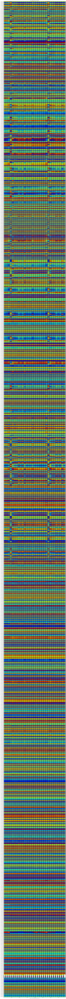

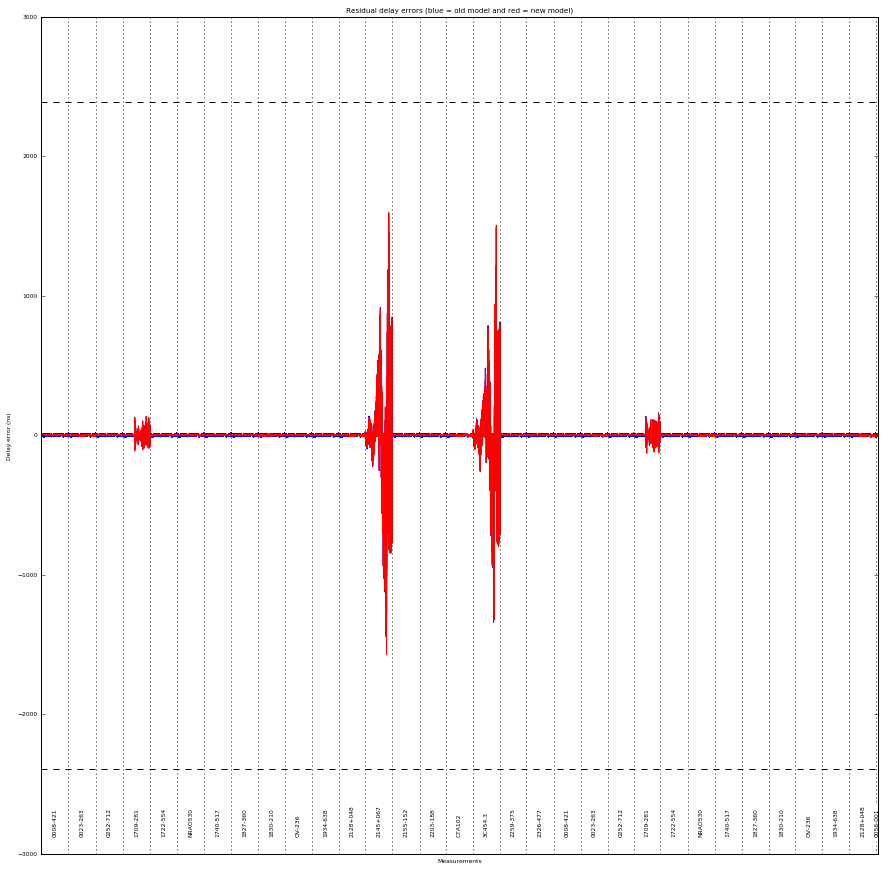

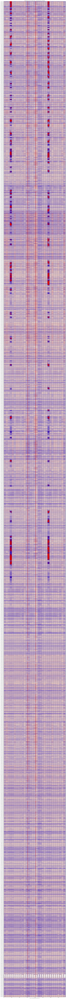

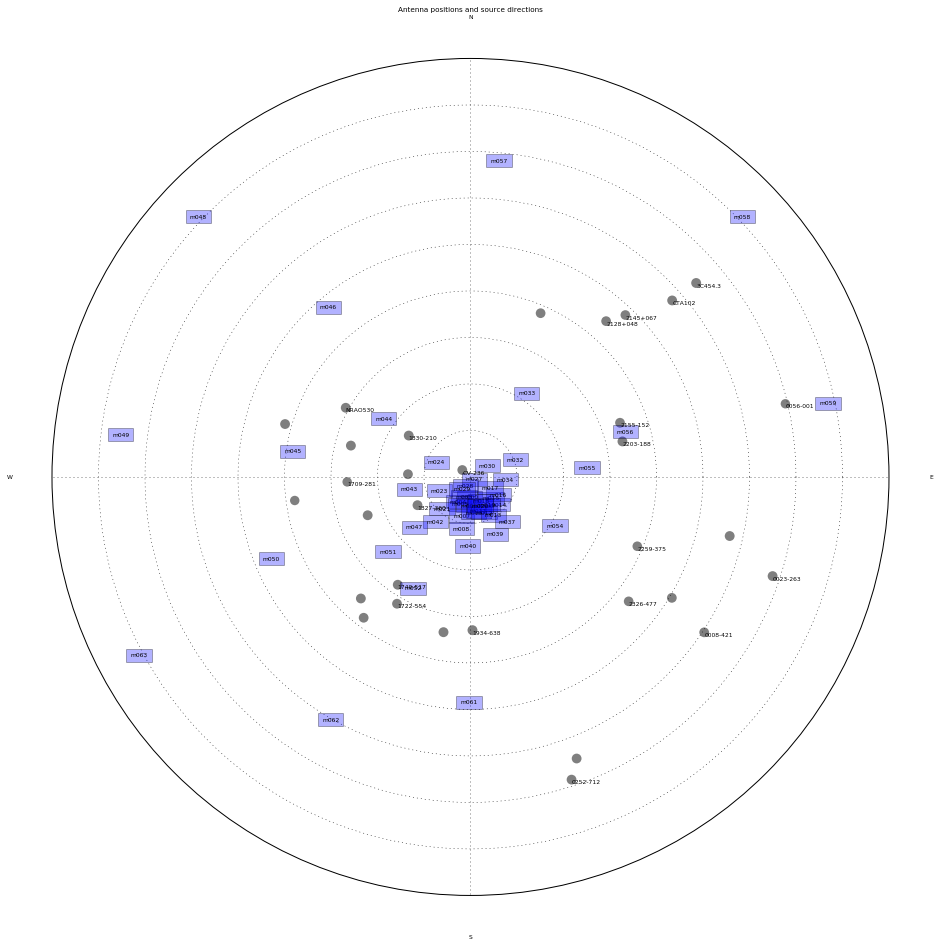

In [16]:
figure(1,figsize=(15,240))
figure(2,figsize=(15,15))
figure(3,figsize=(15,240))
figure(4,figsize=(15,15))
%run /var/kat/katsdpscripts/reduction/baseline_cal_reduction.py -f 2200,2914 -p 'H' -r $ref_ant \
 -a $ants $h5_filename



Loading and processing data...

DEBUG: Found int_time=3.998308486 in telstate['sdp_l0_int_time']
DEBUG: Found scale_factor_timestamp=1712000000.0 in telstate[u'i0_scale_factor_timestamp']
DEBUG: Found sync_time=1525035378.0 in telstate[u'i0_sync_time']
DEBUG: Found n_chans=4096 in telstate['sdp_l0_n_chans']
DEBUG: Found bandwidth=856000000.0 in telstate['sdp_l0_bandwidth']
DEBUG: Found center_freq=1284000000.0 in telstate['sdp_l0_center_freq']
antennas (51): m000, m003, m004, m005 (*ref*), m006, m007, m008, m009, m011, m012, m013, m014, m015, m016, m017, m018, m019, m020, m021, m023, m024, m027, m028, m029, m030, m032, m033, m034, m037, m039, m040, m042, m043, m044, m045, m046, m047, m048, m049, m050, m051, m052, m054, m055, m056, m057, m058, m059, m061, m062, m063 [pol V]
baselines (1275): 0-1 0-2 1-2 0-3 1-3 2-3 0-4 1-4 2-4 3-4 0-5 1-5 2-5 3-5 4-5 0-6 1-6 2-6 3-6 4-6 5-6 0-7 1-7 2-7 3-7 4-7 5-7 6-7 0-8 1-8 2-8 3-8 4-8 5-8 6-8 7-8 0-9 1-9 2-9 3-9 4-9 5-9 6-9 7-9 8-9 0-10 1-10 2-10 3-

scan   3 (  32 samples) 0.030 0.032 0.031 0.032 0.031 0.034 0.030 0.031 0.031 0.033 0.030 0.031 0.032 0.032 0.031 0.031 0.031 0.032 0.033 0.031 0.030 0.033 0.032 0.033 0.035 0.033 0.033 0.034 0.032 0.031 0.032 0.032 0.032 0.030 0.032 0.033 0.031 0.030 0.031 0.032 0.032 0.030 0.031 0.032 0.032 0.032 0.031 0.032 0.032 0.031 0.032 0.033 0.032 0.030 0.032 0.032 0.032 0.034 0.033 0.033 0.030 0.033 0.035 0.031 0.033 0.033 0.031 0.029 0.031 0.031 0.031 0.031 0.031 0.031 0.031 0.030 0.031 0.032 0.030 0.031 0.031 0.033 0.030 0.029 0.031 0.032 0.029 0.031 0.031 0.032 0.031 0.031 0.032 0.033 0.032 0.032 0.031 0.032 0.034 0.030 0.032 0.031 0.031 0.032 0.031 0.030 0.031 0.033 0.032 0.031 0.030 0.031 0.033 0.032 0.030 0.032 0.032 0.031 0.030 0.031 0.032 0.032 0.032 0.034 0.031 0.029 0.031 0.033 0.031 0.031 0.032 0.033 0.032 0.030 0.033 0.030 0.032 0.032 0.034 0.033 0.032 0.030 0.032 0.034 0.031 0.033 0.034 0.032 0.032 0.030 0.033 0.032 0.031 0.029 0.031 0.032 0.032 0.030 0.030 0.031 0.034 0.031 0.03

scan   7 (  32 samples) 0.052 0.056 0.055 0.053 0.056 0.059 0.053 0.052 0.055 0.053 0.050 0.051 0.054 0.054 0.053 0.056 0.055 0.058 0.057 0.055 0.056 0.055 0.055 0.057 0.058 0.055 0.055 0.056 0.055 0.054 0.055 0.055 0.052 0.054 0.054 0.052 0.057 0.055 0.058 0.057 0.052 0.056 0.053 0.055 0.051 0.055 0.057 0.058 0.059 0.055 0.054 0.058 0.057 0.056 0.054 0.056 0.057 0.061 0.060 0.058 0.056 0.058 0.060 0.057 0.053 0.056 0.055 0.053 0.057 0.057 0.055 0.053 0.055 0.056 0.052 0.052 0.057 0.054 0.054 0.053 0.058 0.056 0.053 0.050 0.056 0.055 0.053 0.054 0.053 0.056 0.053 0.053 0.056 0.058 0.057 0.057 0.053 0.057 0.055 0.052 0.056 0.057 0.057 0.051 0.053 0.053 0.053 0.052 0.056 0.054 0.052 0.055 0.054 0.054 0.056 0.055 0.057 0.056 0.055 0.055 0.056 0.055 0.057 0.060 0.057 0.053 0.059 0.053 0.054 0.060 0.055 0.058 0.055 0.053 0.053 0.054 0.055 0.057 0.058 0.057 0.054 0.054 0.057 0.055 0.051 0.054 0.055 0.061 0.057 0.052 0.056 0.054 0.058 0.053 0.053 0.054 0.053 0.052 0.054 0.055 0.057 0.055 0.05

scan  11 (  32 samples) 0.033 0.036 0.035 0.036 0.035 0.037 0.035 0.034 0.036 0.036 0.034 0.035 0.036 0.036 0.035 0.036 0.035 0.037 0.037 0.036 0.035 0.036 0.035 0.036 0.037 0.036 0.035 0.037 0.034 0.034 0.036 0.036 0.034 0.035 0.035 0.037 0.035 0.035 0.037 0.036 0.035 0.034 0.036 0.036 0.035 0.036 0.035 0.037 0.037 0.036 0.035 0.036 0.036 0.036 0.036 0.036 0.036 0.038 0.038 0.036 0.036 0.037 0.037 0.036 0.036 0.037 0.035 0.034 0.036 0.036 0.034 0.034 0.035 0.036 0.035 0.034 0.034 0.035 0.034 0.034 0.036 0.036 0.035 0.034 0.036 0.036 0.034 0.035 0.036 0.035 0.034 0.036 0.035 0.036 0.037 0.035 0.034 0.036 0.036 0.036 0.036 0.035 0.037 0.034 0.035 0.035 0.035 0.036 0.036 0.036 0.034 0.036 0.035 0.034 0.035 0.036 0.036 0.035 0.034 0.035 0.036 0.035 0.037 0.037 0.037 0.035 0.037 0.036 0.036 0.035 0.035 0.037 0.036 0.035 0.036 0.036 0.036 0.036 0.038 0.038 0.036 0.035 0.037 0.037 0.036 0.036 0.036 0.037 0.036 0.036 0.036 0.037 0.037 0.034 0.034 0.034 0.036 0.034 0.033 0.035 0.035 0.034 0.03

scan  15 (  32 samples) 0.034 0.035 0.035 0.035 0.035 0.037 0.034 0.034 0.035 0.036 0.033 0.033 0.034 0.035 0.033 0.035 0.034 0.036 0.036 0.035 0.034 0.036 0.035 0.037 0.036 0.035 0.034 0.036 0.034 0.033 0.035 0.035 0.033 0.033 0.034 0.035 0.034 0.034 0.036 0.035 0.034 0.034 0.035 0.036 0.034 0.035 0.035 0.036 0.036 0.035 0.034 0.035 0.036 0.034 0.035 0.035 0.035 0.037 0.036 0.036 0.034 0.036 0.036 0.035 0.035 0.036 0.033 0.033 0.035 0.035 0.033 0.033 0.034 0.035 0.033 0.034 0.035 0.035 0.033 0.033 0.035 0.035 0.033 0.033 0.034 0.035 0.033 0.033 0.034 0.035 0.033 0.034 0.034 0.036 0.036 0.034 0.034 0.035 0.035 0.034 0.035 0.035 0.036 0.034 0.034 0.034 0.033 0.036 0.035 0.034 0.033 0.035 0.035 0.034 0.034 0.035 0.035 0.034 0.034 0.034 0.035 0.035 0.036 0.037 0.036 0.034 0.036 0.036 0.035 0.036 0.036 0.036 0.035 0.035 0.036 0.035 0.035 0.035 0.037 0.037 0.036 0.035 0.037 0.037 0.036 0.036 0.036 0.038 0.035 0.035 0.036 0.035 0.036 0.034 0.034 0.035 0.035 0.034 0.034 0.035 0.035 0.034 0.03

scan  19 (  32 samples) 0.047 0.046 0.048 0.048 0.046 0.045 0.047 0.043 0.048 0.046 0.045 0.043 0.043 0.045 0.044 0.045 0.047 0.047 0.049 0.047 0.045 0.048 0.047 0.050 0.048 0.046 0.047 0.049 0.046 0.045 0.046 0.046 0.047 0.042 0.045 0.047 0.045 0.045 0.047 0.048 0.045 0.046 0.047 0.051 0.047 0.046 0.046 0.047 0.048 0.046 0.046 0.048 0.049 0.047 0.047 0.048 0.046 0.048 0.049 0.047 0.046 0.049 0.048 0.045 0.049 0.048 0.045 0.044 0.046 0.046 0.045 0.042 0.046 0.047 0.043 0.046 0.046 0.046 0.046 0.044 0.046 0.046 0.045 0.043 0.046 0.045 0.044 0.047 0.046 0.045 0.041 0.045 0.046 0.048 0.048 0.044 0.046 0.049 0.049 0.048 0.045 0.046 0.048 0.045 0.045 0.046 0.043 0.046 0.044 0.044 0.043 0.047 0.047 0.044 0.046 0.045 0.045 0.042 0.043 0.046 0.046 0.046 0.047 0.048 0.045 0.046 0.047 0.050 0.048 0.044 0.046 0.050 0.046 0.047 0.046 0.046 0.049 0.046 0.047 0.045 0.046 0.044 0.049 0.048 0.046 0.048 0.047 0.047 0.043 0.044 0.047 0.043 0.049 0.044 0.046 0.046 0.048 0.045 0.044 0.046 0.048 0.044 0.04

scan  23 (  31 samples) 0.060 0.065 0.059 0.062 0.059 0.066 0.058 0.062 0.063 0.064 0.061 0.058 0.060 0.061 0.062 0.061 0.061 0.062 0.064 0.062 0.060 0.062 0.065 0.067 0.065 0.063 0.065 0.062 0.059 0.061 0.066 0.065 0.062 0.060 0.063 0.061 0.061 0.060 0.062 0.062 0.059 0.058 0.061 0.066 0.063 0.060 0.061 0.063 0.064 0.061 0.062 0.060 0.063 0.063 0.060 0.065 0.063 0.064 0.066 0.063 0.062 0.064 0.067 0.064 0.065 0.067 0.061 0.058 0.060 0.062 0.059 0.058 0.061 0.063 0.061 0.059 0.062 0.062 0.061 0.058 0.062 0.065 0.060 0.058 0.060 0.065 0.059 0.060 0.063 0.062 0.058 0.061 0.059 0.061 0.064 0.060 0.060 0.062 0.064 0.063 0.059 0.060 0.064 0.061 0.059 0.059 0.059 0.062 0.062 0.060 0.061 0.060 0.062 0.060 0.060 0.059 0.062 0.063 0.062 0.060 0.063 0.060 0.062 0.063 0.064 0.061 0.063 0.064 0.061 0.061 0.064 0.065 0.061 0.061 0.063 0.066 0.065 0.061 0.062 0.066 0.063 0.061 0.065 0.070 0.065 0.062 0.063 0.067 0.058 0.060 0.062 0.065 0.064 0.060 0.059 0.061 0.066 0.060 0.059 0.063 0.064 0.060 0.06

scan  27 (  32 samples) 0.057 0.055 0.057 0.057 0.058 0.060 0.055 0.057 0.056 0.057 0.054 0.054 0.055 0.055 0.053 0.058 0.056 0.058 0.059 0.056 0.055 0.056 0.056 0.057 0.058 0.057 0.055 0.058 0.055 0.052 0.056 0.057 0.055 0.053 0.056 0.054 0.055 0.054 0.056 0.057 0.055 0.055 0.057 0.056 0.053 0.056 0.056 0.059 0.059 0.056 0.055 0.057 0.057 0.055 0.056 0.057 0.057 0.059 0.060 0.057 0.056 0.058 0.060 0.057 0.058 0.058 0.054 0.053 0.056 0.055 0.054 0.052 0.055 0.057 0.053 0.056 0.057 0.056 0.053 0.054 0.055 0.057 0.055 0.054 0.055 0.056 0.052 0.054 0.055 0.056 0.053 0.057 0.055 0.057 0.057 0.056 0.053 0.057 0.057 0.054 0.057 0.058 0.058 0.055 0.054 0.055 0.055 0.057 0.056 0.055 0.053 0.056 0.057 0.054 0.057 0.057 0.056 0.054 0.053 0.054 0.055 0.056 0.058 0.059 0.057 0.055 0.057 0.058 0.057 0.057 0.057 0.057 0.056 0.053 0.059 0.055 0.056 0.056 0.059 0.057 0.057 0.055 0.059 0.056 0.055 0.057 0.057 0.059 0.056 0.055 0.057 0.054 0.058 0.054 0.054 0.055 0.056 0.055 0.053 0.056 0.055 0.054 0.05

scan  31 (  32 samples) 0.035 0.036 0.036 0.037 0.037 0.038 0.035 0.035 0.036 0.036 0.034 0.034 0.035 0.037 0.035 0.035 0.036 0.037 0.037 0.036 0.035 0.038 0.037 0.038 0.038 0.036 0.037 0.039 0.035 0.035 0.036 0.036 0.035 0.034 0.036 0.036 0.037 0.036 0.037 0.038 0.036 0.036 0.037 0.038 0.036 0.036 0.036 0.038 0.038 0.036 0.036 0.036 0.039 0.036 0.036 0.038 0.036 0.038 0.039 0.037 0.036 0.038 0.039 0.037 0.038 0.039 0.035 0.035 0.036 0.036 0.035 0.035 0.036 0.037 0.034 0.035 0.035 0.038 0.036 0.035 0.036 0.037 0.035 0.034 0.036 0.037 0.035 0.036 0.036 0.035 0.034 0.036 0.036 0.037 0.037 0.036 0.035 0.037 0.038 0.035 0.035 0.036 0.037 0.036 0.036 0.036 0.034 0.037 0.037 0.036 0.035 0.037 0.037 0.035 0.036 0.037 0.036 0.034 0.035 0.037 0.036 0.037 0.037 0.038 0.036 0.035 0.037 0.039 0.036 0.036 0.037 0.038 0.037 0.036 0.036 0.038 0.037 0.037 0.038 0.039 0.038 0.036 0.037 0.040 0.037 0.036 0.037 0.038 0.036 0.036 0.037 0.037 0.037 0.035 0.035 0.036 0.037 0.035 0.035 0.035 0.037 0.035 0.03

scan  35 (  31 samples) 0.084 0.087 0.090 0.092 0.086 0.090 0.089 0.085 0.092 0.090 0.085 0.083 0.084 0.083 0.086 0.089 0.086 0.093 0.094 0.087 0.087 0.089 0.088 0.095 0.093 0.090 0.089 0.090 0.085 0.084 0.089 0.087 0.083 0.085 0.088 0.090 0.085 0.084 0.092 0.090 0.090 0.085 0.088 0.085 0.086 0.086 0.086 0.089 0.089 0.089 0.084 0.089 0.090 0.087 0.089 0.093 0.086 0.095 0.092 0.086 0.087 0.091 0.092 0.088 0.092 0.090 0.085 0.084 0.088 0.088 0.084 0.083 0.087 0.088 0.087 0.084 0.084 0.086 0.086 0.081 0.087 0.087 0.084 0.087 0.087 0.088 0.080 0.085 0.086 0.088 0.082 0.087 0.085 0.089 0.089 0.087 0.083 0.090 0.091 0.086 0.085 0.090 0.087 0.085 0.084 0.084 0.085 0.086 0.087 0.085 0.082 0.089 0.089 0.086 0.084 0.086 0.092 0.084 0.085 0.085 0.088 0.084 0.092 0.091 0.087 0.087 0.092 0.094 0.083 0.088 0.090 0.087 0.087 0.084 0.088 0.087 0.089 0.089 0.091 0.091 0.086 0.085 0.092 0.093 0.087 0.090 0.093 0.094 0.090 0.088 0.090 0.085 0.088 0.085 0.084 0.085 0.086 0.086 0.082 0.087 0.090 0.083 0.08

scan  39 (  32 samples) 0.052 0.053 0.055 0.055 0.055 0.056 0.054 0.052 0.055 0.055 0.052 0.051 0.054 0.053 0.050 0.054 0.052 0.055 0.056 0.053 0.052 0.057 0.054 0.060 0.059 0.057 0.053 0.057 0.053 0.050 0.054 0.053 0.052 0.050 0.053 0.055 0.054 0.052 0.055 0.057 0.054 0.052 0.054 0.053 0.053 0.054 0.053 0.056 0.056 0.052 0.053 0.055 0.057 0.053 0.054 0.055 0.054 0.057 0.056 0.054 0.053 0.056 0.055 0.053 0.054 0.056 0.052 0.053 0.054 0.055 0.052 0.052 0.053 0.055 0.052 0.052 0.054 0.054 0.052 0.050 0.054 0.054 0.052 0.051 0.053 0.054 0.051 0.051 0.053 0.051 0.050 0.054 0.052 0.055 0.054 0.053 0.052 0.053 0.057 0.053 0.053 0.053 0.054 0.053 0.053 0.055 0.052 0.055 0.055 0.052 0.051 0.054 0.055 0.051 0.051 0.053 0.055 0.052 0.052 0.053 0.056 0.055 0.056 0.055 0.054 0.052 0.055 0.056 0.052 0.054 0.053 0.054 0.054 0.053 0.054 0.053 0.054 0.053 0.056 0.057 0.053 0.053 0.055 0.056 0.055 0.054 0.056 0.057 0.053 0.053 0.054 0.055 0.055 0.052 0.051 0.054 0.053 0.052 0.050 0.053 0.054 0.052 0.05

scan  43 (  31 samples) 0.044 0.046 0.045 0.047 0.045 0.047 0.043 0.043 0.045 0.047 0.044 0.042 0.044 0.045 0.045 0.044 0.045 0.045 0.047 0.045 0.044 0.045 0.047 0.048 0.050 0.046 0.046 0.047 0.042 0.044 0.045 0.046 0.045 0.043 0.044 0.046 0.044 0.043 0.046 0.045 0.045 0.045 0.046 0.048 0.047 0.043 0.045 0.046 0.048 0.045 0.045 0.045 0.046 0.043 0.045 0.045 0.046 0.046 0.047 0.045 0.046 0.046 0.048 0.046 0.044 0.046 0.042 0.044 0.045 0.045 0.042 0.044 0.044 0.046 0.044 0.042 0.044 0.043 0.043 0.044 0.044 0.045 0.043 0.043 0.044 0.046 0.043 0.042 0.042 0.043 0.041 0.043 0.044 0.045 0.047 0.044 0.044 0.045 0.047 0.043 0.045 0.044 0.046 0.044 0.042 0.042 0.044 0.044 0.045 0.043 0.043 0.044 0.047 0.042 0.045 0.044 0.047 0.043 0.043 0.042 0.044 0.044 0.047 0.047 0.045 0.044 0.047 0.046 0.045 0.044 0.045 0.047 0.044 0.045 0.046 0.047 0.046 0.044 0.047 0.046 0.047 0.045 0.047 0.049 0.046 0.045 0.047 0.047 0.046 0.045 0.048 0.047 0.045 0.042 0.043 0.044 0.045 0.043 0.043 0.044 0.045 0.042 0.04

scan  47 (  32 samples) 0.047 0.054 0.050 0.051 0.051 0.050 0.054 0.050 0.054 0.055 0.049 0.051 0.052 0.051 0.048 0.051 0.050 0.052 0.053 0.052 0.054 0.051 0.052 0.055 0.055 0.051 0.048 0.058 0.048 0.049 0.051 0.051 0.053 0.052 0.049 0.054 0.052 0.051 0.052 0.052 0.051 0.052 0.049 0.056 0.050 0.052 0.051 0.053 0.052 0.053 0.051 0.051 0.056 0.048 0.050 0.052 0.053 0.056 0.055 0.051 0.048 0.054 0.054 0.053 0.053 0.053 0.050 0.049 0.049 0.051 0.049 0.050 0.049 0.056 0.048 0.050 0.050 0.054 0.049 0.049 0.052 0.051 0.048 0.047 0.053 0.049 0.052 0.050 0.053 0.049 0.052 0.048 0.048 0.052 0.052 0.054 0.051 0.051 0.053 0.048 0.050 0.051 0.053 0.052 0.049 0.054 0.052 0.049 0.051 0.050 0.050 0.050 0.053 0.049 0.049 0.050 0.054 0.049 0.052 0.053 0.051 0.050 0.052 0.050 0.053 0.052 0.051 0.053 0.050 0.050 0.052 0.055 0.051 0.049 0.048 0.053 0.052 0.050 0.051 0.053 0.051 0.053 0.050 0.057 0.051 0.052 0.051 0.057 0.047 0.054 0.053 0.052 0.053 0.051 0.050 0.048 0.050 0.051 0.050 0.050 0.054 0.048 0.04

scan  51 (  32 samples) 0.034 0.036 0.036 0.037 0.037 0.038 0.036 0.036 0.037 0.038 0.037 0.036 0.037 0.036 0.035 0.036 0.036 0.037 0.038 0.038 0.037 0.036 0.036 0.038 0.037 0.037 0.037 0.038 0.035 0.035 0.036 0.038 0.036 0.036 0.036 0.037 0.036 0.036 0.037 0.038 0.036 0.036 0.036 0.037 0.035 0.037 0.036 0.037 0.038 0.037 0.036 0.037 0.037 0.036 0.038 0.037 0.037 0.039 0.039 0.037 0.037 0.038 0.038 0.037 0.037 0.038 0.036 0.035 0.038 0.037 0.036 0.036 0.036 0.038 0.035 0.036 0.038 0.038 0.036 0.035 0.038 0.037 0.036 0.036 0.036 0.037 0.035 0.036 0.037 0.037 0.035 0.037 0.037 0.038 0.038 0.036 0.035 0.038 0.036 0.036 0.038 0.037 0.038 0.037 0.037 0.037 0.036 0.037 0.037 0.035 0.034 0.038 0.037 0.035 0.037 0.036 0.038 0.036 0.036 0.036 0.036 0.036 0.038 0.038 0.036 0.036 0.037 0.038 0.037 0.036 0.038 0.039 0.036 0.037 0.038 0.036 0.038 0.038 0.038 0.038 0.037 0.036 0.038 0.040 0.036 0.038 0.037 0.040 0.037 0.037 0.038 0.036 0.038 0.035 0.035 0.036 0.036 0.036 0.036 0.036 0.036 0.035 0.03

scan  55 (  31 samples) 0.026 0.029 0.030 0.026 0.027 0.031 0.026 0.028 0.028 0.029 0.028 0.027 0.029 0.028 0.029 0.030 0.028 0.030 0.031 0.030 0.027 0.029 0.028 0.030 0.030 0.030 0.027 0.028 0.027 0.027 0.029 0.028 0.029 0.026 0.027 0.028 0.028 0.028 0.029 0.028 0.029 0.027 0.028 0.029 0.026 0.028 0.028 0.029 0.029 0.028 0.028 0.030 0.030 0.029 0.029 0.029 0.028 0.029 0.030 0.030 0.030 0.029 0.031 0.030 0.029 0.030 0.028 0.028 0.029 0.029 0.027 0.028 0.030 0.028 0.028 0.029 0.028 0.030 0.027 0.028 0.028 0.029 0.028 0.027 0.027 0.028 0.027 0.026 0.029 0.027 0.029 0.027 0.028 0.030 0.028 0.028 0.028 0.031 0.028 0.029 0.030 0.029 0.030 0.026 0.029 0.028 0.027 0.028 0.030 0.029 0.026 0.027 0.028 0.026 0.027 0.029 0.029 0.030 0.026 0.030 0.028 0.027 0.030 0.029 0.029 0.027 0.029 0.028 0.026 0.027 0.029 0.031 0.030 0.028 0.029 0.027 0.030 0.029 0.029 0.031 0.031 0.028 0.027 0.028 0.028 0.028 0.031 0.029 0.030 0.027 0.031 0.028 0.028 0.028 0.026 0.030 0.028 0.029 0.027 0.029 0.029 0.027 0.02

scan  59 (  32 samples) 0.016 0.016 0.016 0.017 0.016 0.017 0.016 0.016 0.017 0.016 0.016 0.016 0.016 0.016 0.016 0.017 0.016 0.017 0.017 0.016 0.016 0.016 0.016 0.017 0.017 0.017 0.016 0.017 0.016 0.016 0.016 0.016 0.016 0.015 0.016 0.016 0.016 0.016 0.017 0.017 0.016 0.016 0.016 0.016 0.016 0.016 0.016 0.017 0.017 0.016 0.016 0.016 0.017 0.016 0.016 0.017 0.016 0.017 0.017 0.017 0.016 0.017 0.017 0.017 0.017 0.017 0.016 0.016 0.016 0.017 0.016 0.016 0.016 0.016 0.016 0.016 0.016 0.016 0.016 0.016 0.016 0.016 0.016 0.015 0.016 0.016 0.015 0.016 0.016 0.016 0.016 0.016 0.016 0.017 0.017 0.016 0.016 0.016 0.016 0.016 0.016 0.016 0.017 0.016 0.016 0.016 0.016 0.016 0.017 0.016 0.016 0.016 0.016 0.016 0.016 0.016 0.017 0.016 0.016 0.016 0.016 0.016 0.017 0.017 0.017 0.016 0.017 0.016 0.016 0.016 0.017 0.017 0.016 0.016 0.016 0.016 0.016 0.016 0.017 0.017 0.017 0.016 0.017 0.017 0.016 0.016 0.017 0.017 0.016 0.016 0.017 0.016 0.017 0.016 0.016 0.016 0.017 0.016 0.016 0.016 0.016 0.016 0.01

scan  63 (   3 samples) 0.121 0.127 0.111 0.118 0.119 0.128 0.118 0.114 0.117 0.112 0.111 0.119 0.124 0.120 0.120 0.123 0.118 0.122 0.129 0.121 0.120 0.124 0.133 0.133 0.129 0.129 0.112 0.127 0.120 0.119 0.115 0.119 0.115 0.113 0.118 0.119 0.114 0.126 0.121 0.121 0.118 0.111 0.118 0.123 0.105 0.118 0.122 0.122 0.129 0.129 0.114 0.117 0.129 0.124 0.113 0.127 0.123 0.132 0.121 0.126 0.112 0.128 0.127 0.122 0.118 0.118 0.118 0.115 0.123 0.115 0.112 0.110 0.120 0.125 0.114 0.115 0.124 0.118 0.113 0.118 0.119 0.113 0.110 0.114 0.120 0.122 0.112 0.123 0.113 0.113 0.109 0.114 0.117 0.120 0.123 0.118 0.120 0.120 0.127 0.126 0.117 0.121 0.121 0.120 0.113 0.107 0.121 0.120 0.123 0.119 0.112 0.126 0.124 0.112 0.113 0.120 0.124 0.114 0.113 0.123 0.114 0.119 0.124 0.125 0.118 0.118 0.121 0.122 0.122 0.121 0.121 0.122 0.115 0.117 0.115 0.119 0.127 0.128 0.131 0.130 0.124 0.111 0.123 0.125 0.125 0.134 0.120 0.124 0.115 0.115 0.120 0.125 0.119 0.112 0.110 0.116 0.119 0.111 0.120 0.119 0.133 0.119 0.11

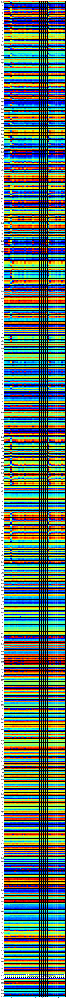

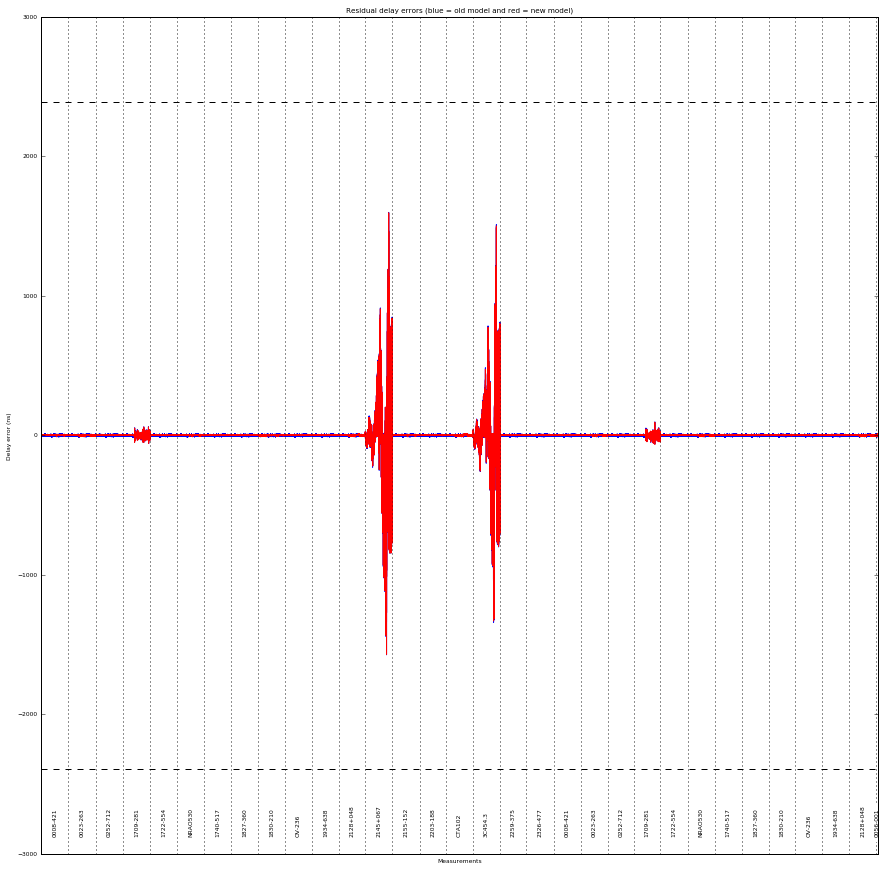

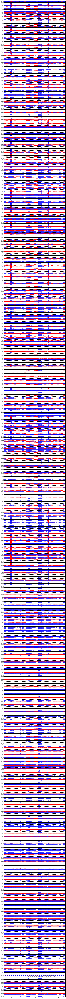

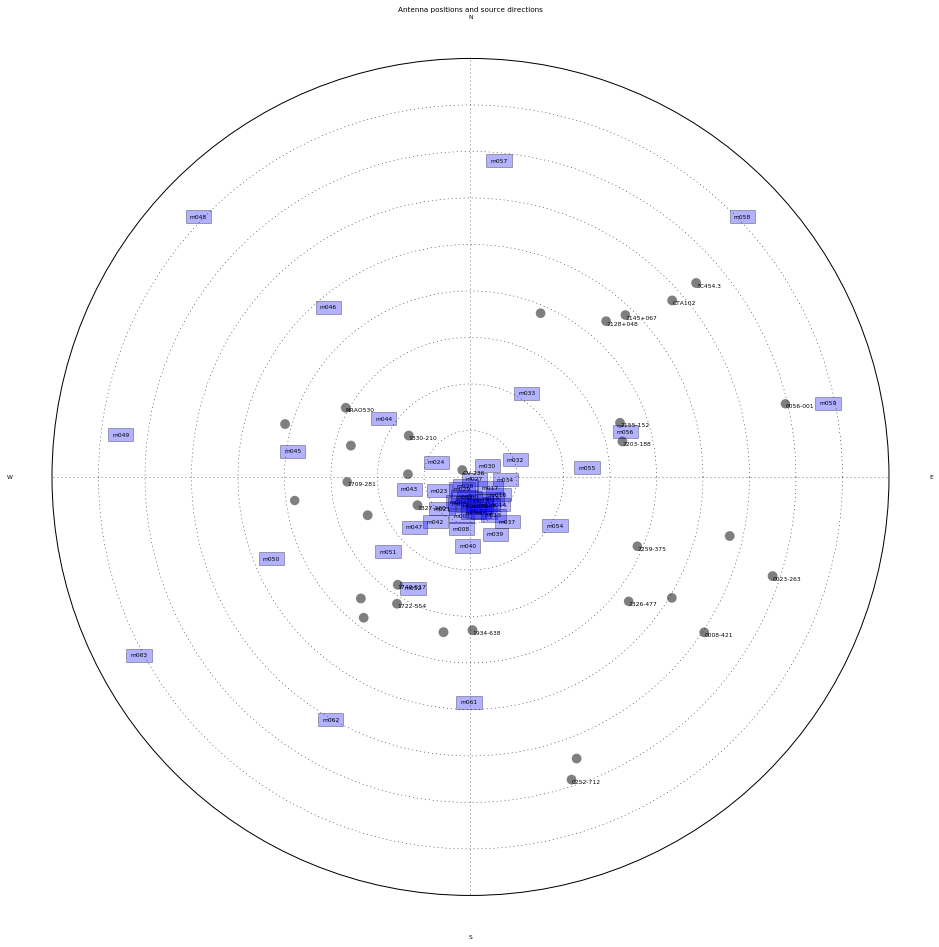

In [17]:
figure(1,figsize=(15,240))
figure(2,figsize=(15,15))
figure(3,figsize=(15,240))
figure(4,figsize=(15,15))
%run -e /var/kat/katsdpscripts/reduction/baseline_cal_reduction.py -f 2200,2914 -p 'V' -r $ref_ant \
 -a $ants $h5_filename


In [18]:
res_h = !python /var/kat/katsdpscripts/reduction/baseline_cal_reduction.py -f 2200,2914 -p 'H' -r $ref_ant \
  -a $ants  $h5_filename
print "Done H"

Done H


In [19]:
res_v = !python /var/kat/katsdpscripts/reduction/baseline_cal_reduction.py -f 2200,2914 -p 'V' -r $ref_ant \
  -a $ants $h5_filename
print "Done V"

Done V


In [20]:
delays_h = {}
for i,r in enumerate(res_h):
    if r.startswith('Antenna'):
        ant = r[8:12]
        delays_h[ant] = {}
        delays_h[ant]['E'] = float(res_h[i+2].split(':')[1].lstrip().split(' ')[0])
        delays_h[ant]['N'] = float(res_h[i+3].split(':')[1].lstrip().split(' ')[0])
        delays_h[ant]['U'] = float(res_h[i+4].split(':')[1].lstrip().split(' ')[0])
        delays_h[ant]['D'] = float(res_h[i+5].split(':')[1].lstrip().split(' ')[0])
delays_h

{'m000': {'D': 5875.366, 'E': -8.259, 'N': -207.256, 'U': 1.143},
 'm003': {'D': 5872.877, 'E': -66.515, 'N': -202.258, 'U': 0.85},
 'm004': {'D': 5873.033, 'E': -123.616, 'N': -252.953, 'U': 1.128},
 'm005': {'D': 5877.82, 'E': -102.088, 'N': -283.12, 'U': 1.475},
 'm006': {'D': 5879.774, 'E': -18.225, 'N': -295.399, 'U': 1.729},
 'm007': {'D': 5888.276, 'E': -89.579, 'N': -402.748, 'U': 2.404},
 'm008': {'D': 5874.784, 'E': -93.515, 'N': -535.053, 'U': 3.111},
 'm009': {'D': 5850.376, 'E': 32.352, 'N': -370.957, 'U': 2.531},
 'm011': {'D': 5882.132, 'E': 84.002, 'N': -351.928, 'U': 2.447},
 'm012': {'D': 5863.075, 'E': 140.008, 'N': -368.085, 'U': 2.674},
 'm013': {'D': 5863.325, 'E': 236.773, 'N': -393.248, 'U': 3.275},
 'm014': {'D': 5869.555, 'E': 280.646, 'N': -285.537, 'U': 2.615},
 'm015': {'D': 5918.411, 'E': 210.627, 'N': -218.919, 'U': 1.883},
 'm016': {'D': 5814.071, 'E': 288.114, 'N': -185.62, 'U': 1.912},
 'm017': {'D': 5873.974, 'E': 199.61, 'N': -112.066, 'U': 1.154},
 

In [21]:
delays_v = {}
for i,r in enumerate(res_v):
    if r.startswith('Antenna'):
        ant = r[8:12]
        delays_v[ant] = {}
        delays_v[ant]['E'] = float(res_v[i+2].split(':')[1].lstrip().split(' ')[0])
        delays_v[ant]['N'] = float(res_v[i+3].split(':')[1].lstrip().split(' ')[0])
        delays_v[ant]['U'] = float(res_v[i+4].split(':')[1].lstrip().split(' ')[0])
        delays_v[ant]['D'] = float(res_v[i+5].split(':')[1].lstrip().split(' ')[0])
delays_v

{'m000': {'D': 5875.636, 'E': -8.261, 'N': -207.252, 'U': 1.128},
 'm003': {'D': 5873.767, 'E': -66.517, 'N': -202.257, 'U': 0.846},
 'm004': {'D': 5874.032, 'E': -123.62, 'N': -252.949, 'U': 1.113},
 'm005': {'D': 5878.919, 'E': -102.088, 'N': -283.12, 'U': 1.475},
 'm006': {'D': 5880.916, 'E': -18.229, 'N': -295.386, 'U': 1.696},
 'm007': {'D': 5889.615, 'E': -89.583, 'N': -402.734, 'U': 2.371},
 'm008': {'D': 5876.03, 'E': -93.519, 'N': -535.04, 'U': 3.08},
 'm009': {'D': 5851.734, 'E': 32.351, 'N': -370.945, 'U': 2.508},
 'm011': {'D': 5882.629, 'E': 84.001, 'N': -351.918, 'U': 2.418},
 'm012': {'D': 5864.056, 'E': 140.006, 'N': -368.064, 'U': 2.622},
 'm013': {'D': 5864.159, 'E': 236.772, 'N': -393.22, 'U': 3.22},
 'm014': {'D': 5870.274, 'E': 280.648, 'N': -285.518, 'U': 2.579},
 'm015': {'D': 5918.888, 'E': 210.625, 'N': -218.895, 'U': 1.826},
 'm016': {'D': 5815.085, 'E': 288.14, 'N': -185.601, 'U': 1.839},
 'm017': {'D': 5875.315, 'E': 199.611, 'N': -112.046, 'U': 1.117},
 'm0

# Cross check between polarizations for derived positions

In [22]:
for a in sorted(delays_v):
    print a,
    print("diff E %06.3f") %(delays_h[a]['E'] - delays_v[a]['E']),
    print("diff N %06.3f") %(delays_h[a]['N'] - delays_v[a]['N']),
    print("diff U %06.3f") %(delays_h[a]['U'] - delays_v[a]['U']),
    print("diff D %06.3f") %(delays_h[a]['D'] - delays_v[a]['D'])
    
# expect differences between E,N and U less than 1cm and Delays less than 3m 

m000 diff E 00.002 diff N -0.004 diff U 00.015 diff D -0.270
m003 diff E 00.002 diff N -0.001 diff U 00.004 diff D -0.890
m004 diff E 00.004 diff N -0.004 diff U 00.015 diff D -0.999
m005 diff E 00.000 diff N 00.000 diff U 00.000 diff D -1.099
m006 diff E 00.004 diff N -0.013 diff U 00.033 diff D -1.142
m007 diff E 00.004 diff N -0.014 diff U 00.033 diff D -1.339
m008 diff E 00.004 diff N -0.013 diff U 00.031 diff D -1.246
m009 diff E 00.001 diff N -0.012 diff U 00.023 diff D -1.358
m011 diff E 00.001 diff N -0.010 diff U 00.029 diff D -0.497
m012 diff E 00.002 diff N -0.021 diff U 00.052 diff D -0.981
m013 diff E 00.001 diff N -0.028 diff U 00.055 diff D -0.834
m014 diff E -0.002 diff N -0.019 diff U 00.036 diff D -0.719
m015 diff E 00.002 diff N -0.024 diff U 00.057 diff D -0.477
m016 diff E -0.026 diff N -0.019 diff U 00.073 diff D -1.014
m017 diff E -0.001 diff N -0.020 diff U 00.037 diff D -1.341
m018 diff E 00.005 diff N -0.020 diff U 00.051 diff D -0.732
m019 diff E 00.002 diff 

In [23]:
# write solutions to file
matchRe = re.findall('[0-9]{10,}', h5_filename)
filename='delay_file_'+''.join(matchRe)+'.txt'

with open(filename, 'w') as f:
    for h,v in zip(delays_h,delays_v):
        print >> f, h,v, mean([delays_h[h]['E'],delays_v[v]['E']]) , \
                    mean([delays_h[h]['N'],delays_v[v]['N']]), \
                    mean([delays_h[h]['U'],delays_v[v]['U']]), \
                    delays_h[h]['D'],delays_v[v]['D']
    f.close()

In [24]:
# sort delay file by antenna name and load antennaLOC
sample = open(filename, 'r')
sorter = csv.reader(sample, delimiter=' ')
sort = sorted(sorter, key=operator.itemgetter(1))

with open('ant_loc.csv', 'r') as f:
    tocs = f.read()

In [25]:
cols = ['Ants', 'Delay', 'East', 'North', 'UP', 'TOC']
df = pd.DataFrame(columns=cols)
for line in sort:
    p = re.compile(line[0]+',\s+\d{4}\.\d{1,3}')
    toc = float(p.search(tocs).group()[6:])
    df = df.append(pd.Series(
                             [
                                line[0],
                                line[-2],
                                line[2],
                                line[3],
                                line[4], 
                                toc
                             ], 
                              index=['Ants', 'Delay', 'East', 'North', 'UP', 'TOC']
                            ), ignore_index = True)

In [26]:
deltaTOC, deltaUP = [], []
deltaTOC.append(0)
deltaUP.append(0)
for i in range(1, len(df.TOC[1:])+1):
    deltaTOC.append(df.TOC[i] - df.TOC[i-1])
    deltaUP.append(float(df.UP[i]) - float(df.UP[i-1]))

em  = [' ' for i in range(len(deltaUP))]
df[' '] =  pd.Series(em,  index = df.index)

df['delta UP']  = pd.Series(deltaUP,  index = df.index)
df['delta TOC'] = pd.Series(deltaTOC, index = df.index)

print('\nDelay Solutions and antenna locations\n')
df


Delay Solutions and antenna locations



,Ants,Delay,East,North,UP,TOC,,delta UP,delta TOC
0,m000,5875.366,-8.26,-207.254,1.1355,1052.205,,0.0000,0.000
1,m003,5872.877,-66.516,-202.2575,0.848,1051.754,,-0.2875,-0.451
2,m004,5873.033,-123.618,-252.951,1.1205,1051.976,,0.2725,0.222
3,m005,5877.82,-102.088,-283.12,1.475,1052.430,,0.3545,0.454
4,m006,5879.774,-18.227,-295.3925,1.7125,1052.590,,0.2375,0.160
5,m007,5888.276,-89.581,-402.741,2.3875,1053.092,,0.6750,0.502
6,m008,5874.784,-93.517,-535.0465,3.0955,1053.990,,0.7080,0.898
7,m009,5850.376,32.3515,-370.951,2.5195,1053.549,,-0.5760,-0.441
8,m011,5882.132,84.0015,-351.923,2.4325,1053.521,,-0.0870,-0.028
9,m012,5863.075,140.007,-368.0745,2.648,1053.730,,0.2155,0.209


In [27]:
# send file to ops server to process and push to github

opsServer='ops.kat.ac.za'
rPath='/home/kat/ops_team_sw/utilities/update_delay_models'
cmd = "sshpass -p {} scp -r {} kat@{}:{}".format('kat', filename, opsServer, rPath)
system(cmd)


32512